In [54]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

from utils import *

In [45]:
# Read csv file
df = pd.read_csv("../data/bank_transactions.csv.zip")
df.head()

,TransactionID,CustomerID,CustomerDOB,CustGender,CustLocation,CustAccountBalance,TransactionDate,TransactionTime,TransactionAmount (INR)
0,T1,C5841053,10/1/94,F,JAMSHEDPUR,17819.05,2/8/16,143207,25.0
1,T2,C2142763,4/4/57,M,JHAJJAR,2270.69,2/8/16,141858,27999.0
2,T3,C4417068,26/11/96,F,MUMBAI,17874.44,2/8/16,142712,459.0
3,T4,C5342380,14/9/73,F,MUMBAI,866503.21,2/8/16,142714,2060.0
4,T5,C9031234,24/3/88,F,NAVI MUMBAI,6714.43,2/8/16,181156,1762.5


In [5]:
# Overview the datasets
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048567 entries, 0 to 1048566
Data columns (total 9 columns):
 #   Column                   Non-Null Count    Dtype  
---  ------                   --------------    -----  
 0   TransactionID            1048567 non-null  object 
 1   CustomerID               1048567 non-null  object 
 2   CustomerDOB              1045170 non-null  object 
 3   CustGender               1047467 non-null  object 
 4   CustLocation             1048416 non-null  object 
 5   CustAccountBalance       1046198 non-null  float64
 6   TransactionDate          1048567 non-null  object 
 7   TransactionTime          1048567 non-null  int64  
 8   TransactionAmount (INR)  1048567 non-null  float64
dtypes: float64(2), int64(1), object(6)
memory usage: 72.0+ MB


In [6]:
# check cardianality of categorical features
df.nunique()

TransactionID              1048567
CustomerID                  884265
CustomerDOB                  17254
CustGender                       3
CustLocation                  9355
CustAccountBalance          161328
TransactionDate                 55
TransactionTime              81918
TransactionAmount (INR)      93024
dtype: int64

In [46]:
# Remove high-cardinality categorical features
df.drop(columns=["CustomerID", "TransactionID", "TransactionTime"], inplace=True)

In [4]:
# Check Null columns
df.isna().sum()

CustomerDOB                3397
CustGender                 1100
CustLocation                151
CustAccountBalance         2369
TransactionDate               0
TransactionAmount (INR)       0
dtype: int64

In [47]:
# Remvove Null values form 
df.dropna(inplace=True)

In [10]:
# Describe the datasets
df.describe()

,CustAccountBalance,TransactionAmount (INR)
count,1.041614e+06,1.041614e+06
mean,1.149986e+05,1.566096e+03
std,8.467609e+05,6.561464e+03
min,0.000000e+00,0.000000e+00
25%,4.728140e+03,1.600000e+02
50%,1.676852e+04,4.575000e+02
75%,5.742885e+04,1.200000e+03
max,1.150355e+08,1.560035e+06


### Customer Account Balance

In [12]:
# visualize customer Account Balance
fig = plot_boxplot(
    data=df, 
    x="CustAccountBalance",
    title="Customer Account Balance",
    x_axis="Account Balance",
    y_axis="Frequency")

As we see their outlier in the Customer Account balance so you have to remove these outliers to make the data balance.

In [48]:
# Remove outliers
df = remove_outliers(df, "CustAccountBalance")

### Transaction Amount

In [7]:
# visualize customer Account Balance
fig = plot_boxplot(
    data=df,
    x="TransactionAmount (INR)",
    title="Transaction Amount of Customers",
    x_axis="Amount [INR]"
)

fig.show()

Their is outliers in transaction Amount so we have to remove these outliers to make the data balance.

In [49]:
df = remove_outliers(df, "TransactionAmount (INR)")

### Age

In [14]:
# convert the string date of birth into datetime format
dob = pd.to_datetime(df["CustomerDOB"].astype(str), format='%d/%m/%y', errors = 'coerce')
dob

2         1996-11-26
4         1988-03-24
5         1972-10-08
6         1992-01-26
7         1982-01-27
             ...    
1048561   1992-11-19
1048562   1990-04-08
1048563   1992-02-20
1048565   1978-08-30
1048566   1984-03-05
Name: CustomerDOB, Length: 683474, dtype: datetime64[ns]

In [15]:
dob.describe()

/tmp/ipykernel_8327/3888070834.py:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  dob.describe()


count                  654067
unique                  15052
top       1991-08-06 00:00:00
freq                      627
first     1969-01-01 00:00:00
last      2068-12-31 00:00:00
Name: CustomerDOB, dtype: object

As we see years from 25 - 68 directly converted into 2025 - 2068 instead of 1925 - 1968. so we can't directly change the string into datetime format. we have follow different approch.

In [60]:
df["age"] = (
    df["CustomerDOB"]
    .str.split("/", expand=True)[2]
    .astype(int)
    .apply(lambda x : np.abs(2016 - int("19" + str(x)))if (x >= 20) and (x <= 99) else np.abs(2016 - int("20" + str(x))))
)

In [61]:
df["age"].describe()

count    683474.000000
mean       8626.427269
std       40532.779598
min           0.000000
25%          25.000000
50%          29.000000
75%          35.000000
max      199784.000000
Name: age, dtype: float64

In [76]:
# Remove outliers
df = remove_outliers(df, "age", q1=0.001, q2=0.956)

<AxesSubplot:xlabel='age'>

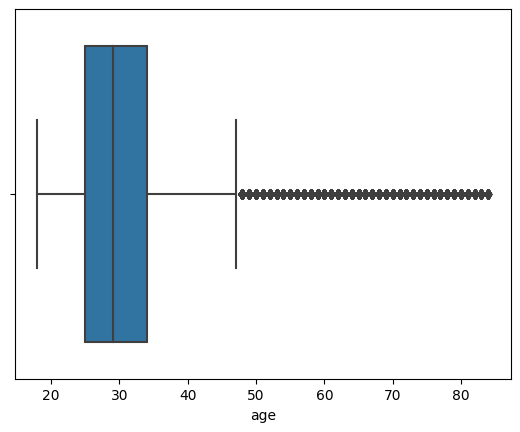

In [77]:
sns.boxplot(
    x = "age",
    data=df
)

### Gender

In [ ]:
df["CustGender"].value_counts()

In [ ]:
x = int(2)

"3" + str(x)

In [ ]:
y = "30"
x = int(y)
type(x)